In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
print(os.listdir("../input"))


import matplotlib.pylab as plt
plt.style.use('fivethirtyeight')
%matplotlib inline
import seaborn as sns
sns.set(style="ticks")
sns.set(rc={'figure.figsize':(15,10)})
# Any results you write to the current directory are saved as output.



['who-suicide-statistics', 'mental-health-in-tech-survey', 'health-nutrition-and-population-statistics', 'suicide-rates-overview-1985-to-2016', 'the-human-freedom-index', 'world-happiness']


In [2]:
wh = pd.read_csv('../input/who-suicide-statistics/who_suicide_statistics.csv')


In [3]:
wh.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43776 entries, 0 to 43775
Data columns (total 6 columns):
country        43776 non-null object
year           43776 non-null int64
sex            43776 non-null object
age            43776 non-null object
suicides_no    41520 non-null float64
population     38316 non-null float64
dtypes: float64(2), int64(1), object(3)
memory usage: 2.0+ MB


In [4]:
wh.dropna(inplace=True)

In [5]:
wh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36060 entries, 24 to 43763
Data columns (total 6 columns):
country        36060 non-null object
year           36060 non-null int64
sex            36060 non-null object
age            36060 non-null object
suicides_no    36060 non-null float64
population     36060 non-null float64
dtypes: float64(2), int64(1), object(3)
memory usage: 1.9+ MB


In [6]:
wh.columns

Index(['country', 'year', 'sex', 'age', 'suicides_no', 'population'], dtype='object')

In [7]:
#https://www.kaggle.com/kikexclusive/curiosity-didn-t-kill-the-cat-all-in-one
from IPython.display import display, HTML
display(wh.describe(include="all").T)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
country,36060,118,Hungary,456,NaN,NaN,NaN,NaN,NaN,NaN,NaN
year,36060,NaN,NaN,NaN,1998.94,10.1639,1979,1991,2000,2008,2016
sex,36060,2,male,18030,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,36060,6,15-24 years,6010,NaN,NaN,NaN,NaN,NaN,NaN,NaN
suicides_no,36060,NaN,NaN,NaN,221.81,855.449,0,2,21,116,22338
population,36060,NaN,NaN,NaN,1.7e+06,3.69781e+06,259,80566,375765,1.3449e+06,4.38052e+07


/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


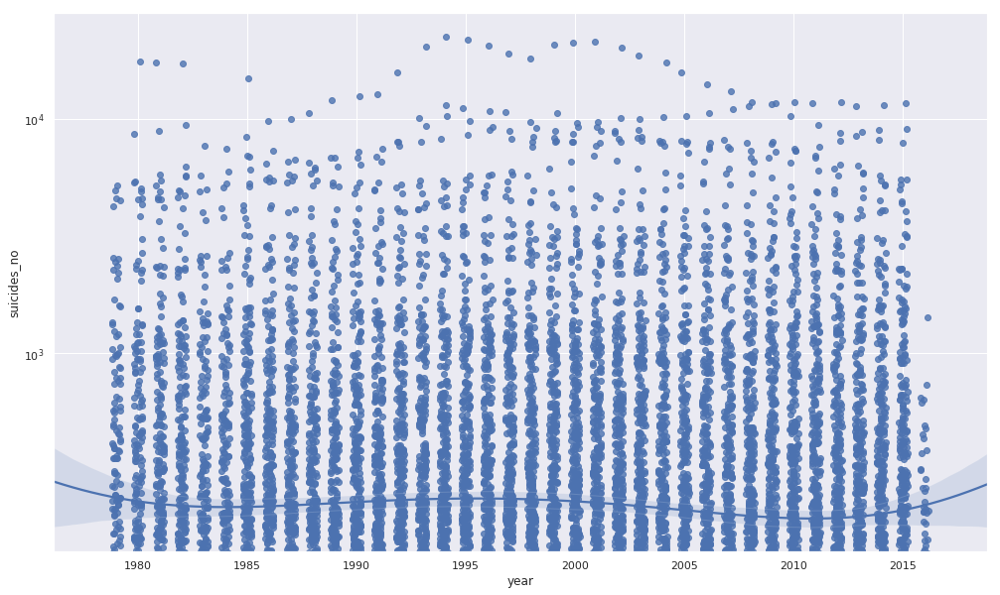

In [8]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.regplot(data=wh, x='year', y='suicides_no', x_jitter=0.2, order=4)
ax.set_yscale('log')

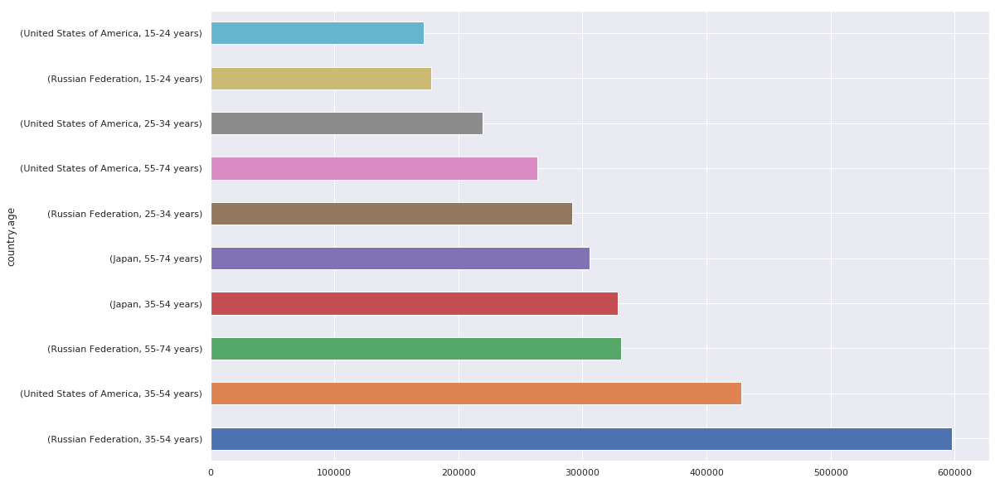

In [9]:
wh.groupby(['country','age']).suicides_no.sum().nlargest(10).plot(kind='barh')

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


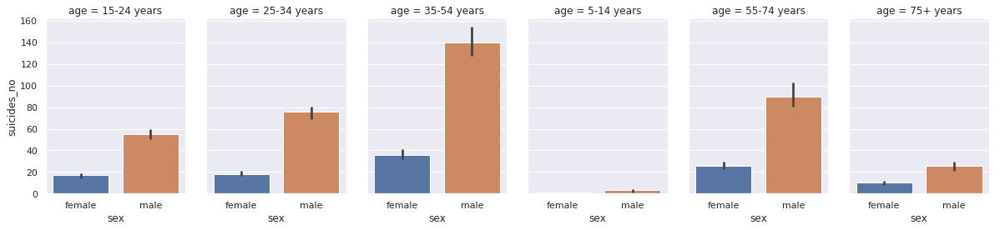

In [10]:
#https://seaborn.pydata.org/generated/seaborn.barplot.html
#https://www.kaggle.com/nadintamer/titanic-survival-predictions-beginner
from numpy import median
ax = sns.catplot(x="sex", y="suicides_no",col='age', data=wh, estimator=median,height=4, aspect=.7,kind='bar')

In [11]:
wh['age'] = wh.age.astype(pd.api.types.CategoricalDtype(categories = ['5-14 years','15-24 years','25-34 years','35-54 years','55-74 years','75+ years']))

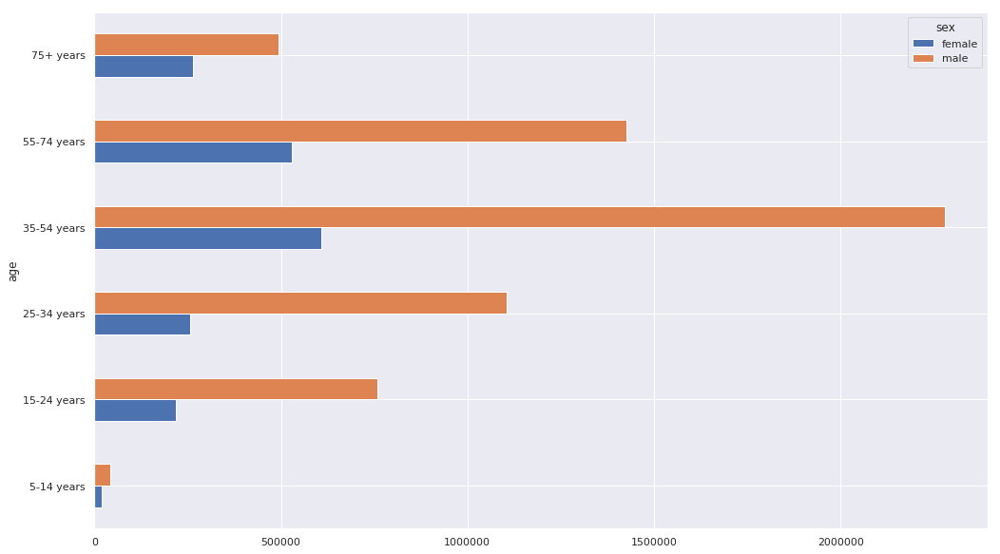

In [12]:
wh.pivot_table(index='age',columns='sex',values='suicides_no', aggfunc='sum').plot(kind='barh')

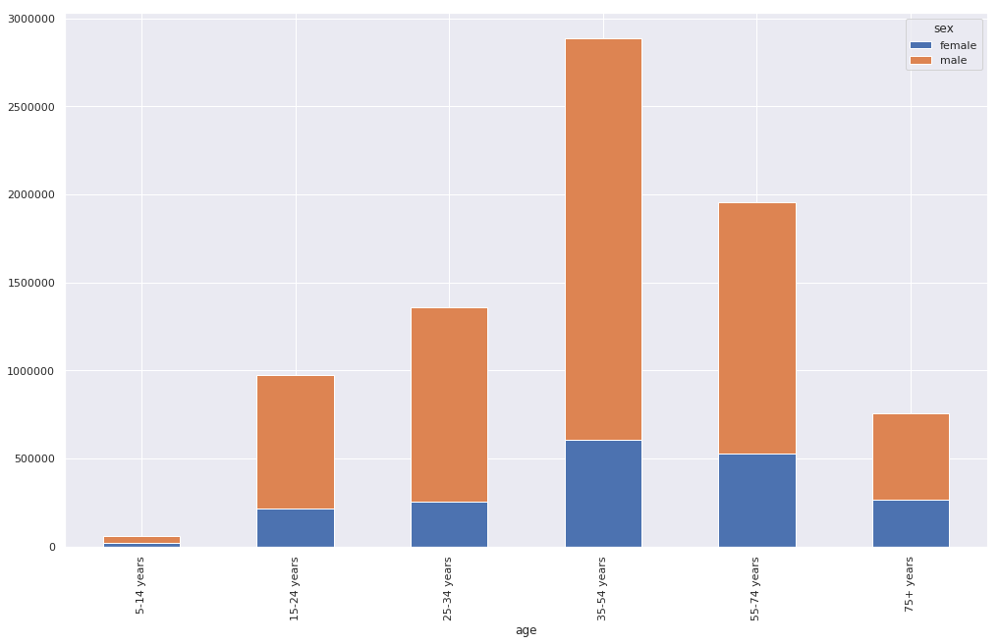

In [13]:
wh.groupby(by=['age','sex'])['suicides_no'].sum().unstack().plot(kind='bar',stacked=True)

In [14]:
wh.groupby(by=['age','sex'])['suicides_no'].sum().unstack().reset_index().melt(id_vars='age')

,age,sex,value
0,5-14 years,female,20152.0
1,15-24 years,female,218309.0
2,25-34 years,female,256427.0
3,35-54 years,female,607420.0
4,55-74 years,female,528359.0
5,75+ years,female,263627.0
6,5-14 years,male,42168.0
7,15-24 years,male,757391.0
8,25-34 years,male,1104353.0
9,35-54 years,male,2280320.0


/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


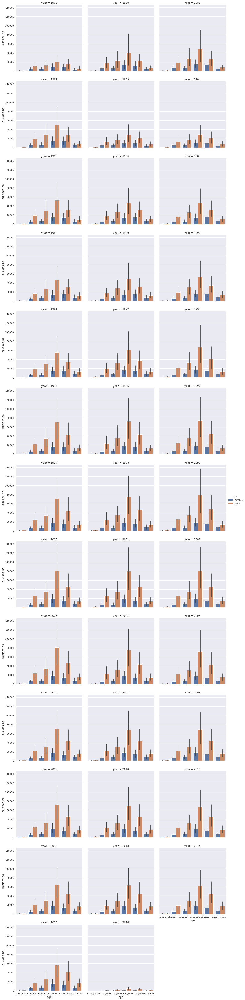

In [15]:
from numpy import sum
sns.catplot('age','suicides_no',hue='sex',col='year',data=wh,kind='bar',col_wrap=3,estimator=sum)

In [16]:
#wh.groupby(['year','age']).suicides_no.sum().reset_index()

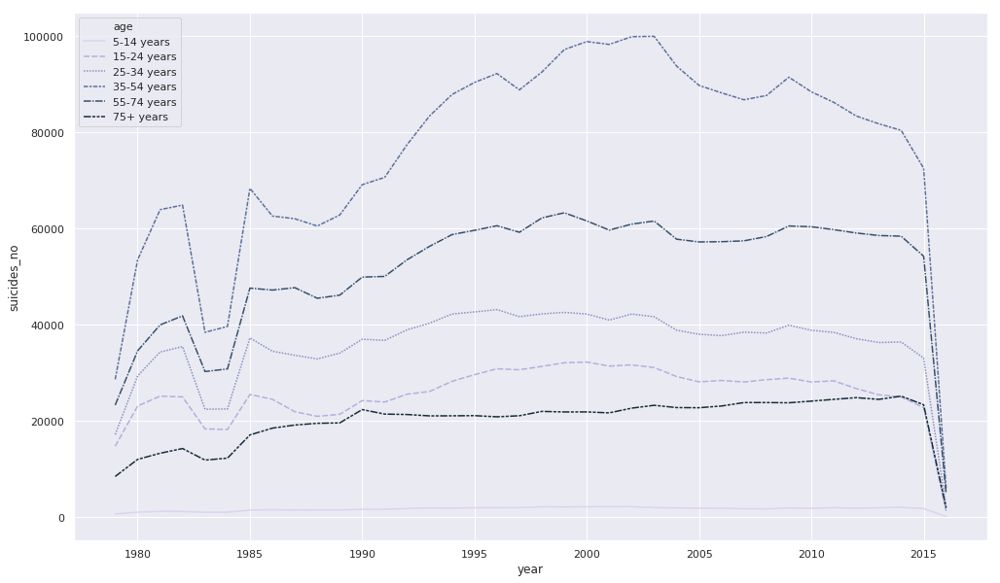

In [17]:
#https://seaborn.pydata.org/generated/seaborn.lineplot.html
from matplotlib.colors import LogNorm
df = wh.groupby(['year','age']).suicides_no.sum().reset_index()
df['age'] = df.age.astype(pd.api.types.CategoricalDtype(categories = ['5-14 years','15-24 years','25-34 years','35-54 years','55-74 years','75+ years']))
sns.set(rc={'figure.figsize':(15,10)})
sns.lineplot('year','suicides_no',hue='age',style='age',data=df,hue_norm=LogNorm(),palette="ch:2.5,.25",sort=False)

In [18]:
#wh.groupby(['year']).suicides_no.sum().plot()

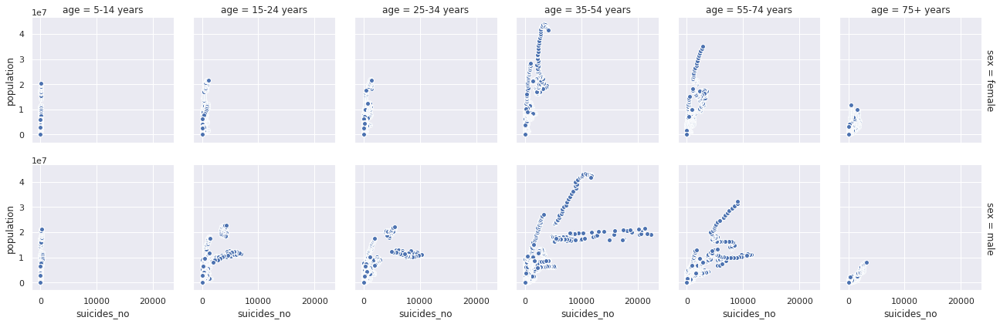

In [19]:
#https://seaborn.pydata.org/examples/faceted_histogram.html
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="darkgrid")

g = sns.FacetGrid(wh, row="sex", col="age", margin_titles=True)

g.map(plt.scatter, "suicides_no","population", edgecolor="w")

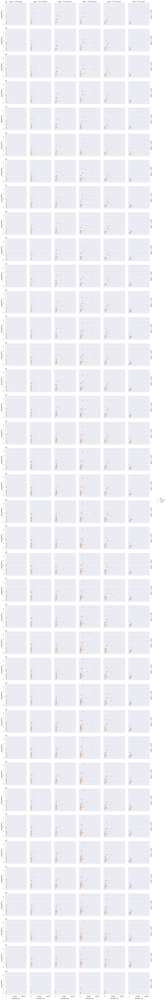

In [20]:
#https://seaborn.pydata.org/examples/faceted_histogram.html
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="darkgrid")

g = sns.FacetGrid(wh, row="year", col="age",hue='sex',margin_titles=True)

(g.map(plt.scatter, "suicides_no","population", edgecolor="w")).add_legend()

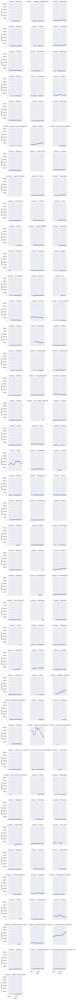

In [21]:

g = sns.FacetGrid(wh.groupby(['country','year']).suicides_no.sum().reset_index(), col="country", col_wrap=3)
g = g.map(plt.plot, "year", "suicides_no", marker=".")

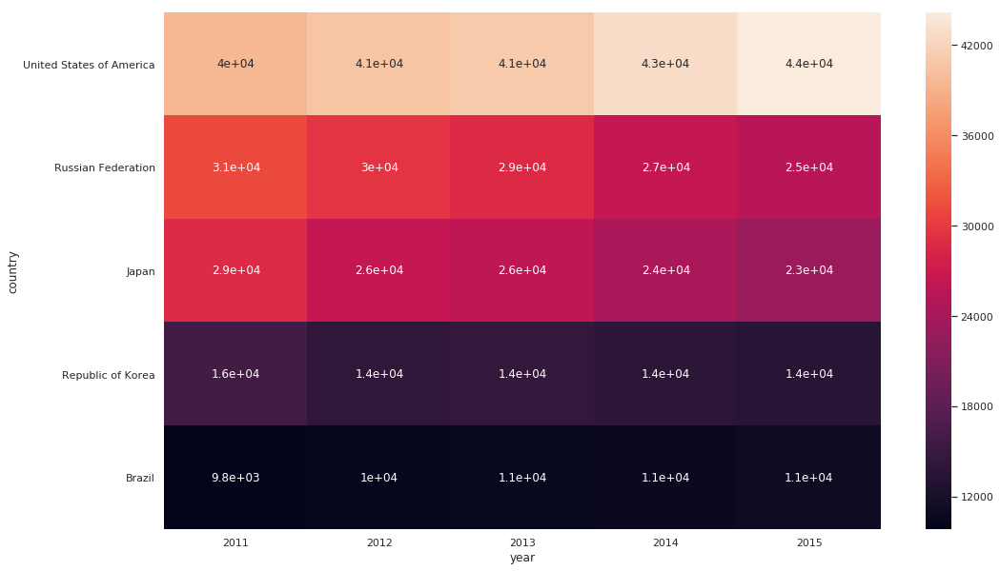

In [22]:
p = pd.crosstab(index=wh.country,columns=wh.year,values=wh.suicides_no,aggfunc='sum')

sns.heatmap(p.loc[:,2011:2015].sort_values(2015, ascending=False).dropna().head(5),annot=True)

pp = pd.crosstab(index=wh.country,columns=wh.year,values=wh.population,aggfunc='sum')

pdivpp = p/pp*10000

#sns.heatmap(pdivpp.loc[:,2006:2015].sort_values(2015, ascending=False).dropna().head(5),annot=True)



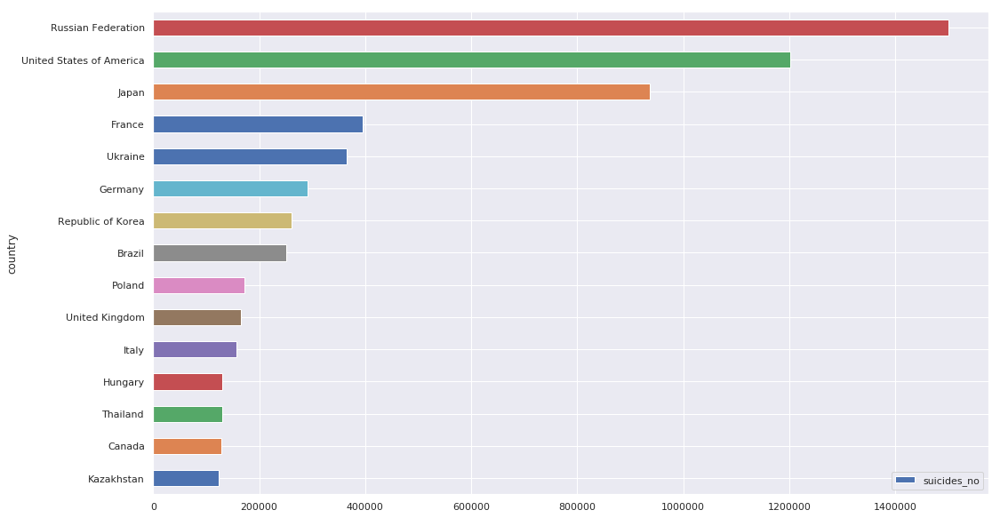

In [23]:
wh.groupby(by=['country'])['suicides_no'].sum().reset_index().sort_values(['suicides_no'],ascending=True).tail(15).plot(x='country',y='suicides_no',kind='barh')

In [30]:
# from sklearn import preprocessing

# x = happiness.values
# min_max_scaler = preprocessing.MinMaxScaler()
# x_scaled = min_max_scaler.fit_transform(x)
# happiness_scaled = pd.DataFrame(x_scaled)
# happiness_scaled.columns = happiness.columns
# happiness_scaled.index = happiness.index
# sns.set(rc={'figure.figsize':(15,30)})
# happiness_scaled[['Family','Health (Life Expectancy)','Freedom','Generosity']].plot(kind='barh',title='Happiness data 2015')

In [31]:
#wh.groupby(by=['year','country'])['suicides_no'].max().reset_index().sort_values(['suicides_no'],ascending=False).head(34)

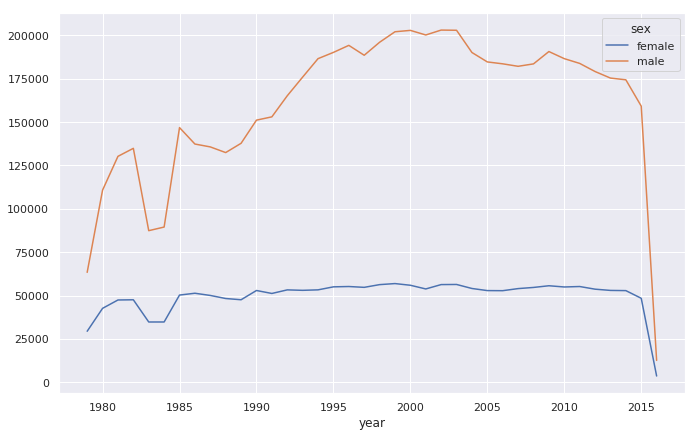

In [32]:
#wh.pivot_table(index='year',columns='sex',values='suicides_no', aggfunc='sum').plot(kind='barh')
sns.set(rc={'figure.figsize':(10,7)})
wh.pivot_table(index='year',columns='sex',values='suicides_no', aggfunc='sum').plot()

In [33]:
wh.groupby(by=['country'])['suicides_no'].sum().reset_index().sort_values(['suicides_no'],ascending=True).tail(15).country

55                   Kazakhstan
20                       Canada
106                    Thailand
47                      Hungary
52                        Italy
112              United Kingdom
79                       Poland
16                       Brazil
83            Republic of Korea
40                      Germany
110                     Ukraine
37                       France
54                        Japan
113    United States of America
88           Russian Federation
Name: country, dtype: object

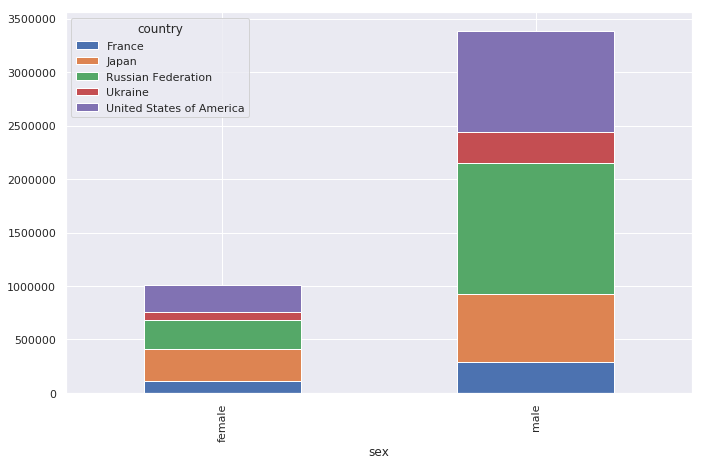

In [34]:
wh[wh.country.isin(wh.groupby(by=['country'])['suicides_no'].sum().reset_index().sort_values(['suicides_no'],ascending=True).tail(5).country)].groupby(by=['sex','country'])['suicides_no'].sum().unstack().plot(kind='bar',stacked=True)

In [35]:
#wh[wh.country.isin(wh.groupby(by=['country'])['suicides_no'].sum().reset_index().sort_values(['suicides_no'],ascending=True).tail(5).country)].groupby(by=['age','country'])['suicides_no'].sum().unstack().plot(kind='bar',stacked=True)

In [36]:
#https://stackoverflow.com/questions/12096252/use-a-list-of-values-to-select-rows-from-a-pandas-dataframehttps://stackoverflow.com/questions/12096252/use-a-list-of-values-to-select-rows-from-a-pandas-dataframe
#wh[wh.country.isin(wh.groupby(by=['country'])['suicides_no'].sum().reset_index().sort_values(['suicides_no'],ascending=True).tail(5).country)].groupby(by=['year','country'])['suicides_no'].sum().unstack().plot()

In [37]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=wh
    )

hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no")
        ]
    )

p = figure(plot_width=700, plot_height=700, tools=[hover],
           title="Mouse over the dots")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
factors = list(wh.sex.unique())
colors = ["red","green"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
p.circle('suicides_no', 'year', size=4, source=source,
    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})

show(p)

Loading BokehJS ...

In [38]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=wh
    )

hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no")
        ]
    )

p = figure(plot_width=700, plot_height=700, tools=[hover],
           title="Mouse over the dots")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
#factors = list(wh.age.unique())
factors = ['5-14 years','15-24 years','25-34 years','35-54 years','55-74 years','75+ years']
colors = ["deepskyblue","maroon","green","peru","greenyellow","yellow"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
p.circle('suicides_no', 'year', size=4, source=source,
    legend='age', fill_alpha=0.2, color = {"field":"age","transform":mapper})

show(p)

Loading BokehJS ...

In [39]:
#wh.plot.scatter(x='population',y='suicides_no')
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=wh
    )


Tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no"),
            ("population","@population")
        ]
p = figure(plot_width=700, plot_height=700,  tooltips=Tooltips,
           title="Mouse over the dots" )
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
factors = list(wh.sex.unique())
colors = ["red","green"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
p.circle('suicides_no', 'population', size=4, source=source,
    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})

show(p)

Loading BokehJS ...

In [40]:
#wh.plot.scatter(x='population',y='suicides_no')
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
'''from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=wh[wh.suicides_no>0]
    )

hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no"),
            ("population","@population")
        ]
    )

p = figure(plot_width=700, plot_height=700, tools=[hover],
           title="Mouse over the dots" ,y_axis_type="log")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
factors = list(wh.sex.unique())
colors = ["red","green"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
p.circle('suicides_no', 'population', size=4, source=source,
    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})

show(p)'''

'from bokeh.plotting import figure, output_file, show, ColumnDataSource\nfrom bokeh.models import HoverTool, CategoricalColorMapper\nfrom bokeh.io import output_notebook\n\noutput_notebook()\n\nsource = ColumnDataSource(\n        data=wh[wh.suicides_no>0]\n    )\n\nhover = HoverTool(\n        tooltips=[\n            ("year", "@year"),\n            ("sex", "@sex"),\n            ("country", "@country"),\n            ("suicides_no","@suicides_no"),\n            ("population","@population")\n        ]\n    )\n\np = figure(plot_width=700, plot_height=700, tools=[hover],\n           title="Mouse over the dots" ,y_axis_type="log")\n#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1\n#https://github.com/bokeh/bokeh/issues/5112\nfactors = list(wh.sex.unique())\ncolors = ["red","green"]\nmapper = CategoricalColorMapper(factors = factors,palette = colors)\np.circle(\'suicides_no\', \'population\', size=4, source=source,\n    legend=\'sex\', fill_alpha=0.2, color = {"field":"sex"

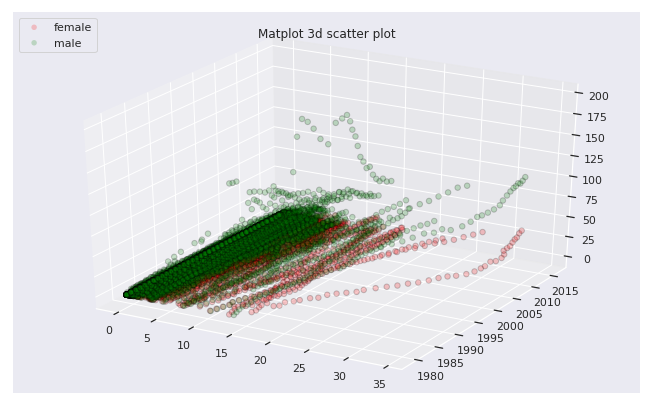

In [41]:
#https://pythonspot.com/3d-scatterplot/
#https://matplotlib.org/gallery/mplot3d/scatter3d.html
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from sklearn.preprocessing import RobustScaler 
#https://www.kaggle.com/janiobachmann/credit-fraud-dealing-with-imbalanced-datasets
rob_scaler = RobustScaler()

wh['scaled_population'] = rob_scaler.fit_transform(wh['population'].values.reshape(-1,1))
wh['scaled_suicides_no'] = rob_scaler.fit_transform(wh['suicides_no'].values.reshape(-1,1))
 
# Create plot
fig = plt.figure()
#ax = fig.add_subplot(1, 1, 1)
#ax = fig.gca(projection='3d')
ax = fig.add_subplot(111, projection='3d')
#ax.set_xscale('log')
wh = wh[wh.suicides_no>0]
ax.scatter(wh[wh.sex=='female'].scaled_population, wh[wh.sex=='female'].year, wh[wh.sex=='female'].scaled_suicides_no, alpha=0.2, c="red", edgecolors='none', s=30, label="female") 
ax.scatter(wh[wh.sex=='male'].scaled_population, wh[wh.sex=='male'].year, wh[wh.sex=='male'].scaled_suicides_no, alpha=0.2, c="green", edgecolors='none', s=30, label="male")


 
plt.title('Matplot 3d scatter plot')
plt.legend(loc=2)
plt.show()

In [42]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
#https://bokeh.pydata.org/en/latest/docs/user_guide/interaction/legends.html#userguide-interaction-legends
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()



hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no")
        ]
    )

p = figure(plot_width=800, plot_height=700,  tools=[hover],
           title="Click on Legend to hide an age category")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
#factors = list(wh.age.unique())
factors = ['5-14 years','15-24 years','25-34 years','35-54 years','55-74 years','75+ years']
source0 = ColumnDataSource(
        data=wh[wh.age==factors[0]]
    )
source1 = ColumnDataSource(
        data=wh[wh.age==factors[1]]
    )
source2 = ColumnDataSource(
        data=wh[wh.age==factors[2]]
    )
source3 = ColumnDataSource(
        data=wh[wh.age==factors[3]]
    )
source4 = ColumnDataSource(
        data=wh[wh.age==factors[4]]
    )
source5 = ColumnDataSource(
        data=wh[wh.age==factors[5]]
    )

colors = ["black","sienna","blue","yellow","darkgreen","lightcoral"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source,
#    legend='age', fill_alpha=0.2, color = {"field":"age","transform":mapper})

#p.circle(wh[wh.age==factors[0]].suicides_no, wh[wh.age==factors[0]].year, color=colors[0], alpha=0.8, legend=factors[0])
#p.circle(wh[wh.age==factors[1]].suicides_no, wh[wh.age==factors[1]].year, color=colors[1], alpha=0.8, legend=factors[1])
#p.circle(wh[wh.age==factors[2]].suicides_no, wh[wh.age==factors[2]].year, color=colors[2], alpha=0.8, legend=factors[2])
#p.circle(wh[wh.age==factors[3]].suicides_no, wh[wh.age==factors[3]].year, color=colors[3], alpha=0.8, legend=factors[3])
#p.circle(wh[wh.age==factors[4]].suicides_no, wh[wh.age==factors[4]].year, color=colors[4], alpha=0.8, legend=factors[4])
#p.circle(wh[wh.age==factors[5]].suicides_no, wh[wh.age==factors[5]].year, color=colors[5], alpha=0.8, legend=factors[5])


#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source0, color=colors[0], alpha=0.8, legend=factors[0])
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source1, color=colors[1], alpha=0.8, legend=factors[1])
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source2, color=colors[2], alpha=0.8, legend=factors[2])
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source3, color=colors[3], alpha=0.8, legend=factors[3])
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source4, color=colors[4], alpha=0.8, legend=factors[4])
#p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range), source=source5, color=colors[5], alpha=0.8, legend=factors[5])

p.circle(x='suicides_no',y = 'year', source=source0, color=colors[0], alpha=0.8, legend=factors[0])
p.circle(x='suicides_no',y =  'year', source=source1, color=colors[1], alpha=0.8, legend=factors[1])
p.circle(x='suicides_no',y =  'year', source=source2, color=colors[2], alpha=0.8, legend=factors[2])
p.circle(x='suicides_no',y =  'year', source=source3, color=colors[3], alpha=0.8, legend=factors[3])
p.circle(x='suicides_no',y =  'year', source=source4, color=colors[4], alpha=0.8, legend=factors[4])
p.circle(x='suicides_no',y =  'year', source=source5, color=colors[5], alpha=0.8, legend=factors[5])


p.legend.click_policy="hide"
p.legend.location = "bottom_center"
p.xaxis.axis_label = 'Number of Suicides'
p.yaxis.axis_label = 'Year'
show(p)

Loading BokehJS ...

In [43]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper, BoxZoomTool,ResetTool,PanTool,WheelZoomTool
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=wh
    )

hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no")
        ]
    )

p = figure(plot_width=500, plot_height=500, tools=[hover],
           title="Mouse over the dots")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
factors = list(wh.sex.unique())
colors = ["red","green"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
from bokeh.transform import jitter




p.circle(x='scaled_suicides_no', y=jitter('year', width=0.6, range=p.y_range),  source=source, alpha=0.3)


p.x_range.range_padding = 0
p.ygrid.grid_line_color = None


#p.circle('suicides_no', 'age', size=4, source=source,
#    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})
p.add_tools(PanTool())
p.add_tools(WheelZoomTool())
p.add_tools(BoxZoomTool())
p.add_tools(ResetTool())
show(p)

Loading BokehJS ...

In [44]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
'''from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper
from bokeh.io import output_notebook

output_notebook()

sourcef = ColumnDataSource(
        data=wh[(wh.country=='Japan')&(wh.sex=='female')]
    )
sourcem = ColumnDataSource(
        data=wh[(wh.country=='Japan')&(wh.sex=='male')]
    )
hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("age", "@age"),
            ("suicides_no","@suicides_no")
        ]
    )

p = figure(plot_width=800, plot_height=700, tools=[hover],
           title="Plot for one country")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
factors = list(wh.sex.unique())
colors = ["red","green"]
mapper = CategoricalColorMapper(factors = factors,palette = colors)
from bokeh.transform import jitter


p.circle(x='scaled_suicides_no', y=jitter('year', width=0.6, range=p.y_range),  color= 'red',source=sourcef, alpha=0.3,legend='sex')
p.circle(x='scaled_suicides_no', y=jitter('year', width=0.6, range=p.y_range),  color= 'green',source=sourcem, alpha=0.3,legend='sex')


p.x_range.range_padding = 0
p.ygrid.grid_line_color = None


#p.circle('suicides_no', 'age', size=4, source=source,
#    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})

show(p)'''

'from bokeh.plotting import figure, output_file, show, ColumnDataSource\nfrom bokeh.models import HoverTool, CategoricalColorMapper\nfrom bokeh.io import output_notebook\n\noutput_notebook()\n\nsourcef = ColumnDataSource(\n        data=wh[(wh.country==\'Japan\')&(wh.sex==\'female\')]\n    )\nsourcem = ColumnDataSource(\n        data=wh[(wh.country==\'Japan\')&(wh.sex==\'male\')]\n    )\nhover = HoverTool(\n        tooltips=[\n            ("year", "@year"),\n            ("sex", "@sex"),\n            ("age", "@age"),\n            ("suicides_no","@suicides_no")\n        ]\n    )\n\np = figure(plot_width=800, plot_height=700, tools=[hover],\n           title="Plot for one country")\n#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1\n#https://github.com/bokeh/bokeh/issues/5112\nfactors = list(wh.sex.unique())\ncolors = ["red","green"]\nmapper = CategoricalColorMapper(factors = factors,palette = colors)\nfrom bokeh.transform import jitter\n\n\np.circle(x=\'scaled_suicides_

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


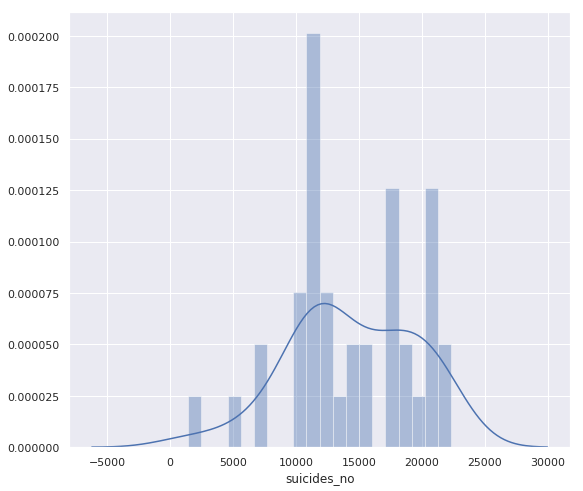

In [45]:
#https://python-graph-gallery.com/20-basic-histogram-seaborn/
sns.set(rc={'figure.figsize':(8,8)})
sns.distplot( wh.groupby('year')["suicides_no"].max(), bins=20 )


In [46]:
#https://python-graph-gallery.com/20-basic-histogram-seaborn/
#sns.set(rc={'figure.figsize':(8,8)})
#sns.distplot( wh.groupby('year')["suicides_no"].std(), bins=20 )

In [47]:
pd.options.display.max_rows = 200
#wh.pivot_table(index='country',columns='year',values=['suicides_no'], aggfunc=['sum']).count()
pivot_table=wh.pivot_table(index='country',columns='year',values=['suicides_no'], aggfunc=['sum'])
pivot_table

sum            ...                   
                                   suicides_no            ...                   
year                                      1979     1980   ...       2015    2016
country                                                   ...                   
Albania                                    NaN      NaN   ...        NaN     NaN
Antigua and Barbuda                        NaN      NaN   ...        1.0     NaN
Argentina                               1802.0   1972.0   ...     3073.0     NaN
Armenia                                    NaN      NaN   ...       74.0    67.0
Aruba                                      NaN      NaN   ...        9.0     NaN
Australia                               1675.0   1606.0   ...     3027.0     NaN
Austria                                    NaN   1932.0   ...     1251.0  1204.0
Azerbaijan                                 NaN      NaN   ...        NaN     NaN
Bahamas                                    NaN      1.0   ...        NaN     NaN
Bahrain                                    NaN      NaN   ...        NaN     NaN
Barbados                                   2.0      3.0   ...        NaN     NaN
Belarus                                    NaN      NaN   ...        NaN     NaN
Belgium                                 2114.0   2178.0   ...     1867.0     NaN
Belize                                     NaN      2.0   ...       26.0     NaN
Bermuda                                    NaN      3.0   ...        NaN     NaN
Bosnia and Herzegovina                     NaN      NaN   ...        NaN     NaN
Brazil                                  3459.0   3864.0   ...    11163.0     NaN
Brunei Darussalam                          NaN      NaN   ...        7.0     NaN
Bulgaria                                   NaN   1206.0   ...        NaN     NaN
Cabo Verde                                 NaN      NaN   ...        NaN     NaN
Canada                                  3355.0   3355.0   ...        NaN     NaN
Chile                                      NaN    539.0   ...     1838.0     NaN
Colombia                                   NaN      NaN   ...     2332.0     NaN
Costa Rica                                 NaN    122.0   ...        NaN     NaN
Croatia                                    NaN      NaN   ...      739.0   683.0
Cuba                                       NaN      NaN   ...     1511.0     NaN
Cyprus                                     NaN      NaN   ...       40.0    36.0
Czech Republic                             NaN      NaN   ...     1387.0  1318.0
Denmark                                    NaN      NaN   ...      564.0     NaN
Dominica                                   NaN      NaN   ...        NaN     NaN
Ecuador                                  242.0    233.0   ...     1073.0     NaN
Egypt                                      NaN     15.0   ...       48.0     NaN
El Salvador                                NaN      NaN   ...        NaN     NaN
Estonia                                    NaN      NaN   ...      195.0     NaN
Fiji                                       NaN      NaN   ...        NaN     NaN
Finland                                    NaN      NaN   ...      731.0     NaN
France                                  9993.0  10406.0   ...        NaN     NaN
French Guiana                              9.0      NaN   ...        NaN     NaN
Georgia                                    NaN      NaN   ...      192.0     NaN
Germany                                    NaN      NaN   ...    10088.0     NaN
Greece                                   277.0    314.0   ...      529.0     NaN
Grenada                                    NaN      NaN   ...        NaN     NaN
Guadeloupe                                 NaN      NaN   ...        NaN     NaN
Guatemala                                 89.0     87.0   ...      494.0     NaN
Guyana                                     NaN      NaN   ...        NaN     NaN
Hong Kong SAR                            661.0    682.0   ...      990.0  

In [48]:
#https://pandas.pydata.org/pandas-docs/stable/generated/pandas.Series.pct_change.html
pivot_table_pct_change = pivot_table.pct_change(axis='columns')
pivot_table_pct_change.columns = pivot_table_pct_change.columns.droplevel().droplevel()
pivot_table_pct_change

year,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Albania,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.136986,0.079365,0.000000,0.000000,-0.308824,0.553191,-0.315068,0.760000,0.011364,0.910112,-0.094118,-0.097403,-0.611511,1.203704,0.117647,-0.067669,0.177419,0.000000,0.000000,-0.150685,0.290323,0.000000,-0.400000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Antigua and Barbuda,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-0.500000,1.000000,0.000000,0.000000,-0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Argentina,NaN,0.094340,0.114097,-0.105599,-0.066667,0.021265,0.061399,0.148893,0.000876,0.029746,-0.045455,-0.047619,-0.088318,0.119426,0.021062,0.004933,-0.016510,0.011343,-0.020188,0.074634,0.032382,0.144862,0.129056,0.009579,0.040164,-0.051079,-0.020186,0.016351,-0.052124,0.038357,-0.057208,0.020458,-0.010533,0.115385,-0.080357,0.081687,-0.048901,0.000000
Armenia,NaN,NaN,NaN,-0.239130,0.000000,0.000000,0.057143,-0.175676,0.327869,-0.246914,0.278689,0.192308,-0.139785,0.037500,0.277108,0.056604,0.160714,-0.330769,-0.114943,-0.142857,0.015152,-0.089552,-0.016393,0.233333,-0.202703,0.000000,0.000000,0.322034,-0.089744,-0.112676,-0.158730,0.377358,-0.082192,0.179104,-0.151899,-0.134328,0.275862,-0.094595
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.125000,0.111111,-0.600000,1.250000,-0.777778,3.000000,0.250000,-0.100000,-0.111111,-0.500000,0.000000,0.750000,0.285714,-0.666667,-0.333333,1.500000,0.800000,0.000000
Australia,NaN,-0.041194,0.040473,0.056852,-0.039071,0.032999,0.061609,0.098334,0.058708,0.003697,-0.048803,0.065828,0.039055,-0.016171,-0.094625,0.120216,-0.049496,0.117972,0.090684,-0.005291,-0.054711,-0.038987,0.028022,-0.056550,-0.070289,-0.019481,0.000000,0.001419,0.052905,0.050247,-0.001709,0.035516,-0.011570,0.078595,0.010853,0.108512,0.047043,0.000000
Austria,NaN,NaN,0.051760,0.018701,-0.014010,-0.006369,0.031065,0.022956,-0.032726,-0.105365,0.025392,-0.038462,-0.030685,-0.005653,-0.031268,0.042254,0.006757,-0.005034,-0.105115,-0.020729,-0.002566,0.021222,-0.062343,0.042982,-0.062460,-0.023352,-0.016174,-0.072909,-0.009252,-0.014008,0.008682,-0.010955,0.018987,-0.009317,0.011755,0.017816,-0.047945,-0.037570
Azerbaijan,NaN,NaN,NaN,-0.167247,0.000000,0.000000,0.020921,-0.036885,0.080851,-0.086614,-0.056034,-0.479452,0.175439,0.074627,-0.173611,-0.605042,0.042553,0.408163,0.550725,-0.476636,-0.035714,0.148148,4.112903,-0.709779,0.402174,-0.162791,0.000000,0.000000,-0.490741,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Bahamas,NaN,NaN,0.000000,0.000000,4.000000,0.400000,-0.857143,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.333333,-0.571429,-0.333333,0.500000,-0.333333,0.500000,1.000000,0.833333,-0.909091,2.000000,-0.666667,1.000000,1.000000,-0.500000,1.500000,-0.200000,0.500000,0.666667,-0.600000,0.250000,0.000000,0.000000,0.000000,0.000000


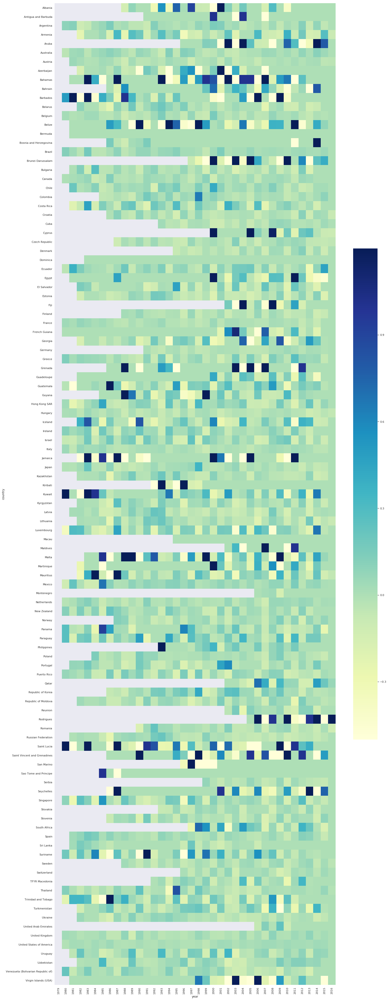

In [49]:
#https://python-graph-gallery.com/92-control-color-in-seaborn-heatmaps/
#https://seaborn.pydata.org/generated/seaborn.heatmap.html
#https://stackoverflow.com/questions/39128856/python-drop-row-if-two-columns-are-nan
#https://stackoverflow.com/questions/48264613/seaborn-heatmap-change-size-of-colorbar?rq=1
#https://stackoverflow.com/questions/27037241/changing-the-rotation-of-tick-labels-in-seaborn-heatmap
sns.set(rc={'figure.figsize':(23,74)})
sns.heatmap(pivot_table_pct_change.dropna(axis=0,thresh=10), cmap="YlGnBu",robust=True,cbar_kws={"shrink": 0.5})
plt.xticks(rotation=90) 
plt.show()

In [50]:
#pivot_table_pct_change.max()

In [51]:
pivot_table_pct_change.T.max().nlargest(5)

country
Bosnia and Herzegovina    61.6
Jamaica                   50.0
Belize                    11.0
Barbados                   8.0
Malta                      8.0
dtype: float64

In [52]:

#pivot_table.T.count().sort_values(ascending=False)

In [53]:
country_data = pivot_table.T.reset_index()


In [54]:

country_data.set_index('year', inplace=True)


In [55]:
#country_data.columns

In [56]:
cols_to_drop_pivot = [0,1]
country_data.drop(country_data.columns[cols_to_drop_pivot], axis=1,inplace=True)

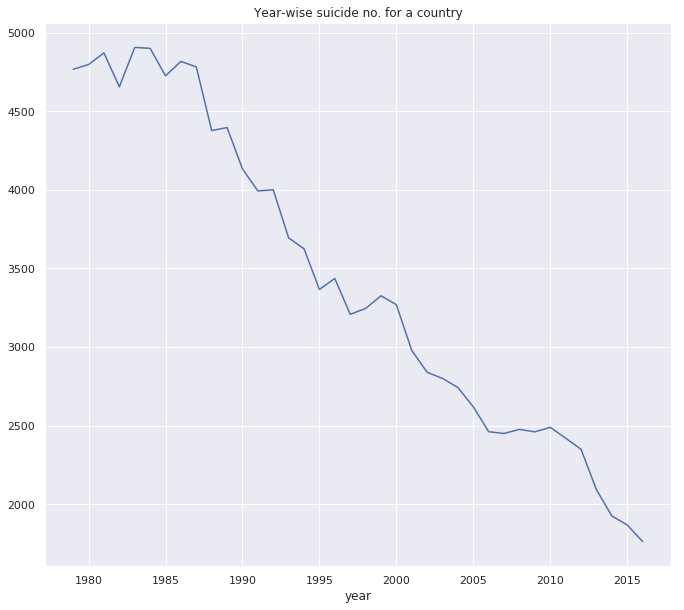

In [57]:
sns.set(rc={'figure.figsize':(10,10)})
country_data['Hungary'].plot(title='Year-wise suicide no. for a country')

In [58]:
pivot_table_pop =wh.pivot_table(index='country',columns='year',values=['population'], aggfunc=['sum'])
pivot_table_pop

sum     ...                
                                     population     ...                
year                                       1979     ...            2016
country                                             ...                
Albania                                     NaN     ...             NaN
Antigua and Barbuda                         NaN     ...             NaN
Argentina                            24986000.0     ...             NaN
Armenia                                     NaN     ...       2400033.0
Aruba                                       NaN     ...             NaN
Australia                            13279400.0     ...             NaN
Austria                                     NaN     ...       8319211.0
Azerbaijan                                  NaN     ...             NaN
Bahamas                                     NaN     ...             NaN
Bahrain                                     NaN     ...             NaN
Barbados                                36500.0     ...             NaN
Belarus                                     NaN     ...             NaN
Belgium                               9249500.0     ...             NaN
Belize                                      NaN     ...             NaN
Bermuda                                     NaN     ...             NaN
Bosnia and Herzegovina                      NaN     ...             NaN
Brazil                              102206100.0     ...             NaN
Brunei Darussalam                           NaN     ...             NaN
Bulgaria                                    NaN     ...             NaN
Cabo Verde                                  NaN     ...             NaN
Canada                               21908000.0     ...             NaN
Chile                                       NaN     ...             NaN
Colombia                                    NaN     ...             NaN
Costa Rica                                  NaN     ...             NaN
Croatia                                     NaN     ...       3567043.0
Cuba                                        NaN     ...             NaN
Cyprus                                      NaN     ...        622053.0
Czech Republic                              NaN     ...       8929942.0
Denmark                                     NaN     ...             NaN
Dominica                                    NaN     ...             NaN
Ecuador                               5461000.0     ...             NaN
Egypt                                       NaN     ...             NaN
El Salvador                                 NaN     ...             NaN
Estonia                                     NaN     ...             NaN
Fiji                                        NaN     ...             NaN
Finland                                     NaN     ...             NaN
France                               49805300.0     ...             NaN
French Guiana                           27000.0     ...             NaN
Georgia                                     NaN     ...             NaN
Germany                                     NaN     ...             NaN
Greece                                8741300.0     ...             NaN
Grenada                                     NaN     ...             NaN
Guadeloupe                                  NaN     ...             NaN
Guatemala                             3571766.0     ...             NaN
Guyana                                      NaN     ...             NaN
Hong Kong SAR                         4056500.0     ...             NaN
Hungary                               9828100.0     ...       8885614.0
Iceland                                     NaN     ...        191318.0
Iran (Islamic Rep of)                       NaN     ...             NaN
Ireland                               2689700.0     ...             NaN
Israel                                2930600.0     ...             NaN
Italy                                53067000.0     ...             NaN
Jamaica     

In [59]:
population_data = pivot_table_pop.T.reset_index()
population_data.set_index('year', inplace=True)
cols_to_drop_pivot = [0,1]
population_data.drop(population_data.columns[cols_to_drop_pivot], axis=1,inplace=True)

In [60]:
suicide_rate_per_lakh = country_data/population_data*100000

In [61]:
suicide_rate_per_lakh_melt = suicide_rate_per_lakh.reset_index().melt(id_vars='year')
#suicide_rate_per_lakh_melt

In [62]:
suicide_rate_per_lakh_melt.iloc[suicide_rate_per_lakh_melt.groupby('year').value.idxmax()]

,year,country,value
1748,1979,Hungary,48.503780
1749,1980,Hungary,48.619065
1750,1981,Hungary,49.158820
1751,1982,Hungary,46.814502
1752,1983,Hungary,49.212065
1753,1984,Hungary,49.066239
1754,1985,Hungary,47.276475
1755,1986,Hungary,48.207602
1756,1987,Hungary,47.892317
1757,1988,Hungary,43.885859


In [63]:
suicide_rate_per_lakh_T = suicide_rate_per_lakh.T


In [64]:
#suicide_rate_per_lakh_T.describe()

In [65]:
#suicide_rate_per_lakh_T.max()

In [66]:
#suicide_rate_per_lakh_T.iloc[:,-2].idxmax()
#2015

In [67]:
suicide_socio_economic = pd.read_csv('../input/suicide-rates-overview-1985-to-2016/master.csv')

In [68]:
suicide_socio_economic.columns

Index(['country', 'year', 'sex', 'age', 'suicides_no', 'population',
       'suicides/100k pop', 'country-year', 'HDI for year',
       ' gdp_for_year ($) ', 'gdp_per_capita ($)', 'generation'],
      dtype='object')

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


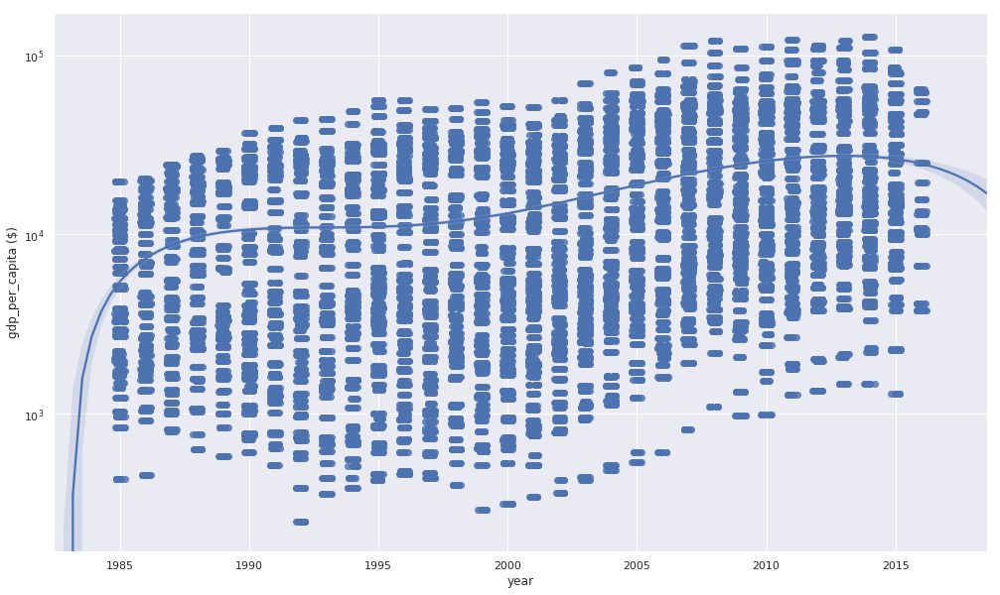

In [69]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.regplot(data=suicide_socio_economic, x='year', y='gdp_per_capita ($)', x_jitter=0.2, order=4)
ax.set_yscale('log')

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


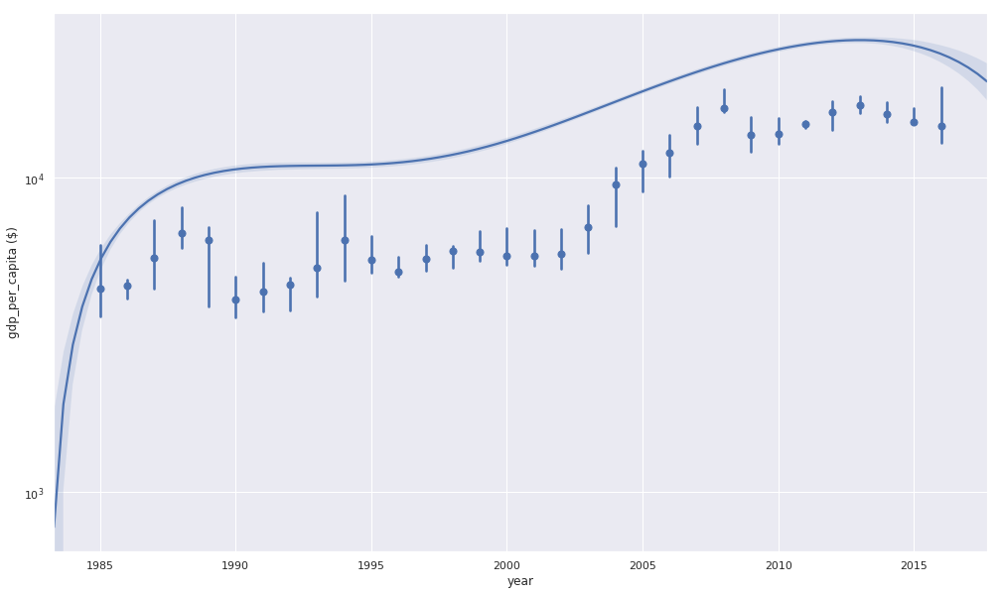

In [70]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.regplot(data=suicide_socio_economic, x='year', y='gdp_per_capita ($)', x_estimator=np.median, x_jitter=0.2, order=4)
ax.set_yscale('log')


In [71]:
#suicide_socio_economic.info()

In [72]:
suicide_socio_economic.year.max()

2016

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


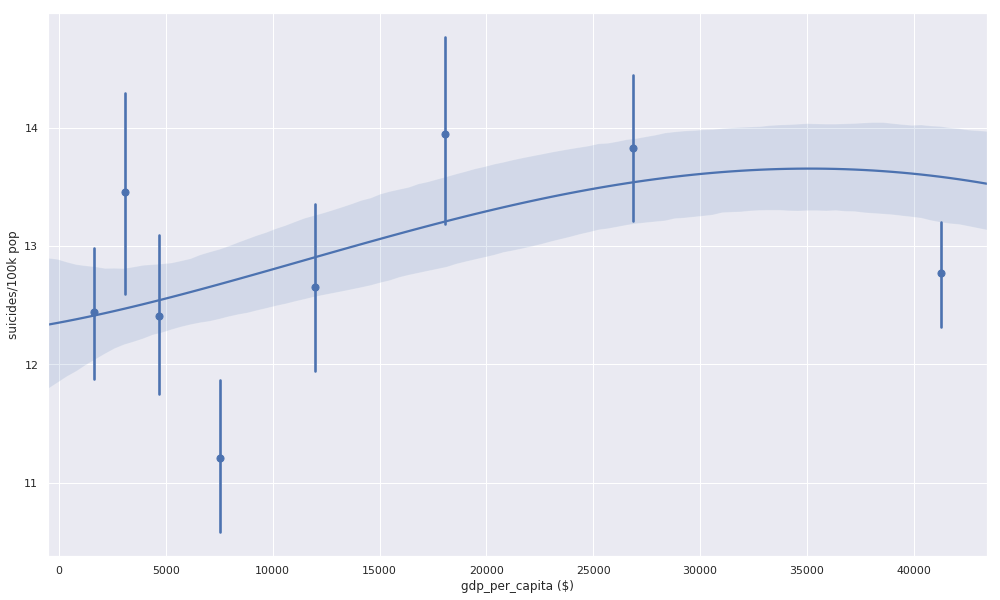

In [73]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
#ax=sns.regplot(data=suicide_socio_economic, x='gdp_per_capita ($)', y='suicides/100k pop', x_estimator=np.median, x_jitter=0.2, order=4, x_bins=5)
ax=sns.regplot(data=suicide_socio_economic, x='gdp_per_capita ($)', y='suicides/100k pop', x_jitter=0.2, order=4, x_bins=8)
#ax.set_yscale('log')
#ax.set_xscale('log')

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


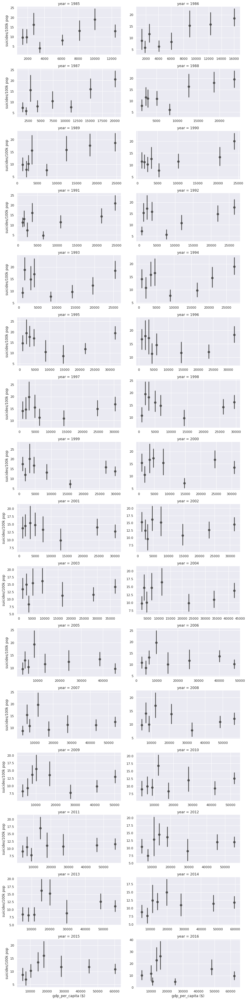

In [74]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
#g = sns.FacetGrid(suicide_socio_economic, col="year", margin_titles=True,col_wrap=2, aspect=2, height=4)
g = sns.FacetGrid(suicide_socio_economic, col="year", margin_titles=True,col_wrap=2, aspect=2, sharex=False, sharey=False)
#g.map(sns.regplot, "gdp_per_capita ($)", "suicides/100k pop", color=".3", x_jitter=.2, order=4, fit_reg=False);
#g.map(sns.regplot, "gdp_per_capita ($)", "suicides/100k pop", color=".3", x_jitter=.2, fit_reg=False).set(yscale='log', xscale='log',xlim=(5, None), ylim=(-3, None))
#g.map(sns.regplot, "gdp_per_capita ($)", "suicides/100k pop", color=".3", x_jitter=.2, fit_reg=False, x_bins=8).set(yscale='log', xscale='log')
g.map(sns.regplot, "gdp_per_capita ($)", "suicides/100k pop", color=".3", x_jitter=.2, fit_reg=False, x_bins=8)


In [75]:
#https://stackoverflow.com/questions/26414913/normalize-columns-of-pandas-data-frame
from sklearn import preprocessing
suicide_socio_economic_mean= suicide_socio_economic.pivot_table(['suicides/100k pop','gdp_per_capita ($)'],
               ['year'], aggfunc='mean')
x = suicide_socio_economic_mean.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
suicide_socio_economic_mean_scaled = pd.DataFrame(x_scaled)
suicide_socio_economic_mean_scaled.columns = suicide_socio_economic_mean.columns
suicide_socio_economic_mean_scaled.index = suicide_socio_economic_mean.index

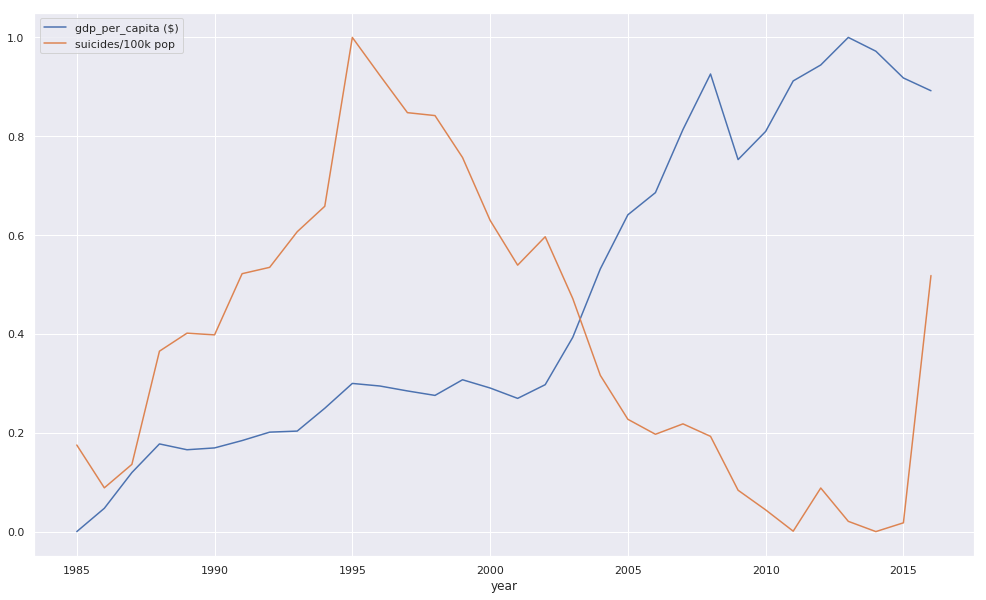

In [76]:
suicide_socio_economic_mean_scaled.plot()

In [77]:
suicide_socio_economic['suicides/100k pop'].corr(suicide_socio_economic['gdp_per_capita ($)'])

0.0017851337973441698

In [78]:
suicide_socio_economic['gdp_per_capita ($)'].describe()

count     27820.000000
mean      16866.464414
std       18887.576472
min         251.000000
25%        3447.000000
50%        9372.000000
75%       24874.000000
max      126352.000000
Name: gdp_per_capita ($), dtype: float64

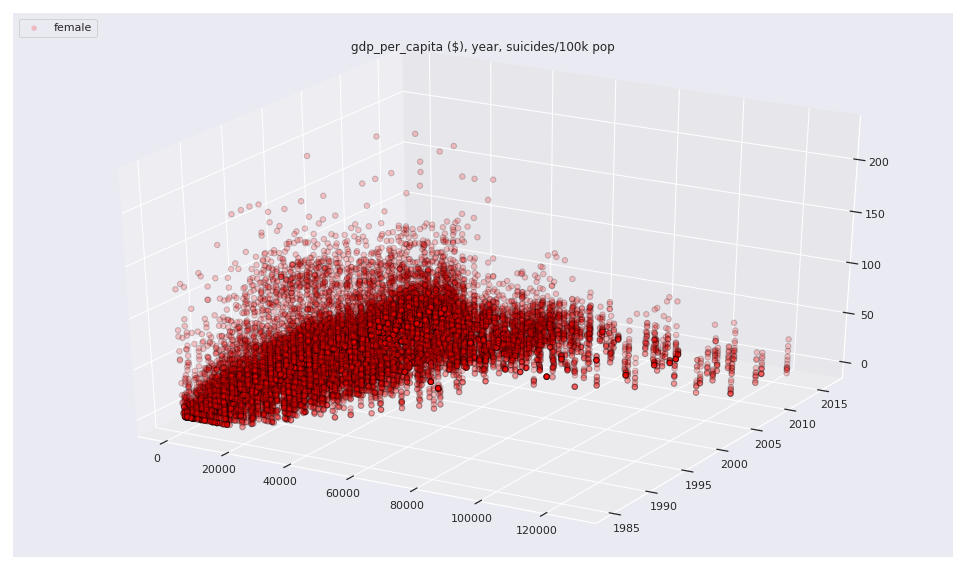

In [79]:
#https://pythonspot.com/3d-scatterplot/
#https://matplotlib.org/gallery/mplot3d/scatter3d.html
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
#https://www.kaggle.com/janiobachmann/credit-fraud-dealing-with-imbalanced-datasets
 
# Create plot
fig = plt.figure()
#ax = fig.add_subplot(1, 1, 1)
#ax = fig.gca(projection='3d')
ax = fig.add_subplot(111, projection='3d')
ax.scatter(suicide_socio_economic['gdp_per_capita ($)'], suicide_socio_economic.year, suicide_socio_economic['suicides/100k pop'], alpha=0.2, c="red", edgecolors='none', s=30, label="female") 
plt.title('gdp_per_capita ($), year, suicides/100k pop')
plt.legend(loc=2)
plt.show()

In [80]:
#https://gist.github.com/dela3499/e159b388258b5f1a7a3bac42fc0179fd
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, CategoricalColorMapper, BoxZoomTool,ResetTool,PanTool,WheelZoomTool
from bokeh.io import output_notebook

output_notebook()

source = ColumnDataSource(
        data=suicide_socio_economic
    )

hover = HoverTool(
        tooltips=[
            ("year", "@year"),
            ("sex", "@sex"),
            ("country", "@country"),
            ("suicides_no","@suicides_no"),
            ("suicides/100k pop","@{suicides/100k pop}"),
            ("gdp_per_capita ($)","@{gdp_per_capita ($)}")
        ]
    )

p = figure(plot_width=500, plot_height=500, tools=[hover],
           title="Suicide and economic data")
#https://www.kaggle.com/kanncaa1/visualization-bokeh-tutorial-part-1
#https://github.com/bokeh/bokeh/issues/5112
#factors = list(suicide_socio_economic.sex.unique())
#colors = ["red","green"]
#mapper = CategoricalColorMapper(factors = factors,palette = colors)
from bokeh.transform import jitter




p.circle(x='suicides_no', y=jitter('year', width=0.6, range=p.y_range),fill_color="orange",  source=source, alpha=0.3)


p.x_range.range_padding = 0
p.ygrid.grid_line_color = None


#p.circle('suicides_no', 'age', size=4, source=source,
#    legend='sex', fill_alpha=0.2, color = {"field":"sex","transform":mapper})
p.add_tools(PanTool())
p.add_tools(WheelZoomTool())
p.add_tools(BoxZoomTool())
p.add_tools(ResetTool())
show(p)

#health['Indicator Name'].describe()

Loading BokehJS ...

In [82]:
#health['Indicator Name'].value_counts()

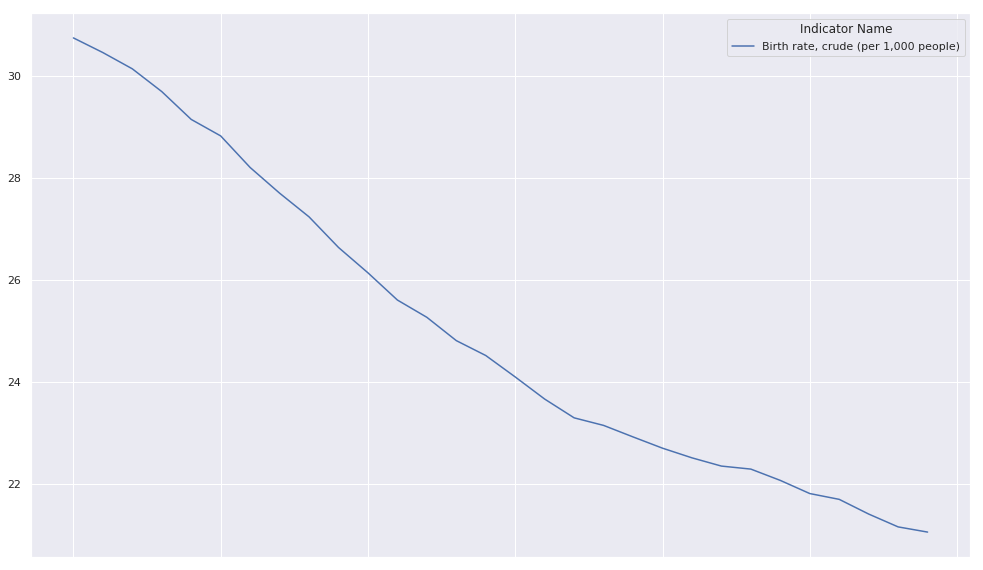

In [83]:
pd.options.display.max_rows = 200
#health['Indicator Name'].value_counts()
#health.info()
#health.describe().T
#health.columns

health[health['Indicator Name'].isin(['Birth rate, crude (per 1,000 people)'])].groupby('Indicator Name').mean().loc[:, '1985':'2015'].T.plot()
#health[health['Indicator Name'].isin(['Labor force, female (% of total labor force)'])].dropna(axis=1)
#health.head()
#Literacy rate, adult male (% of males ages 15 and above) 
#Literacy rate, adult female (% of females ages 15 and above)

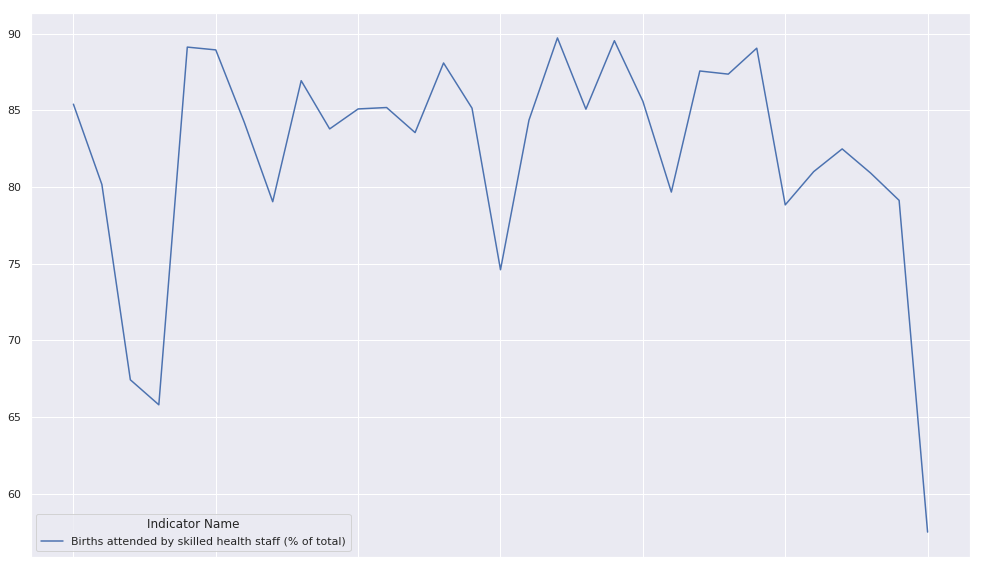

In [84]:
health[health['Indicator Name'].isin(['Births attended by skilled health staff (% of total)'])].groupby('Indicator Name').mean().loc[:, '1985':'2015'].T.plot()
#health.groupby('Indicator Name').mean().loc[:, '1985':'2015']


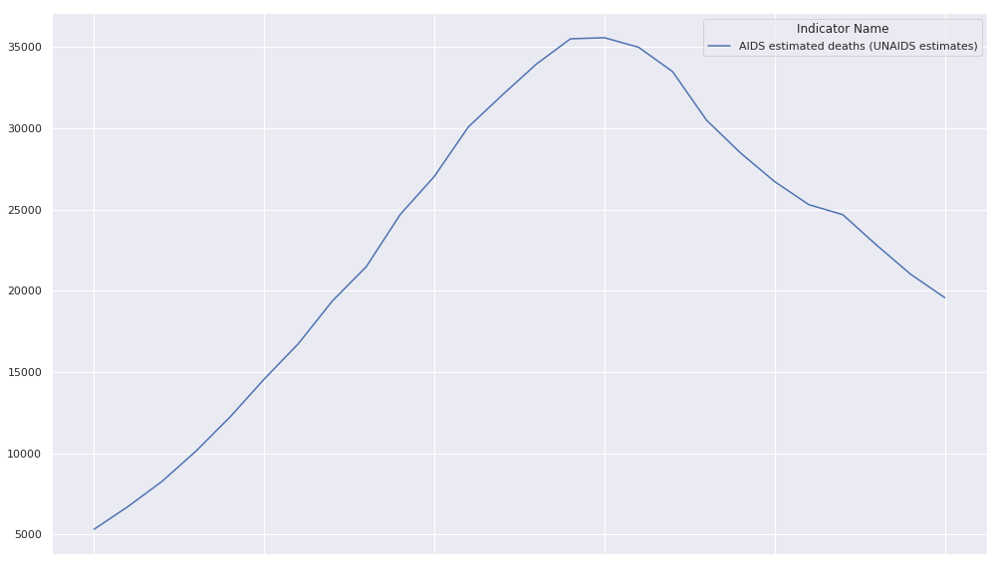

In [85]:
health[health['Indicator Name'].isin(['AIDS estimated deaths (UNAIDS estimates)'])].groupby('Indicator Name').mean().loc[:, '1985':'2015'].T.plot()


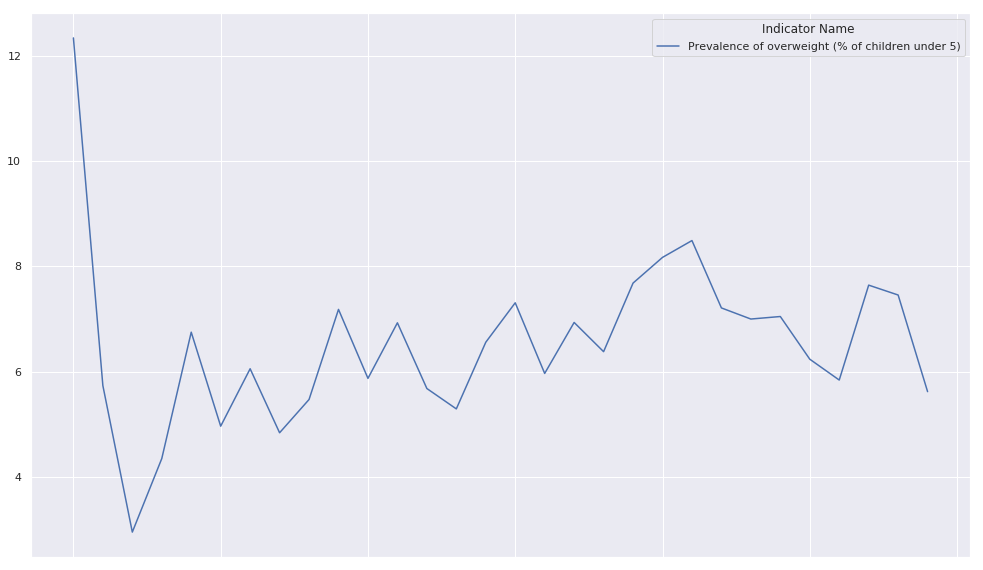

In [86]:
health[health['Indicator Name'].isin(['Prevalence of overweight (% of children under 5)'])].groupby('Indicator Name').mean().loc[:, '1985':'2015'].T.plot()


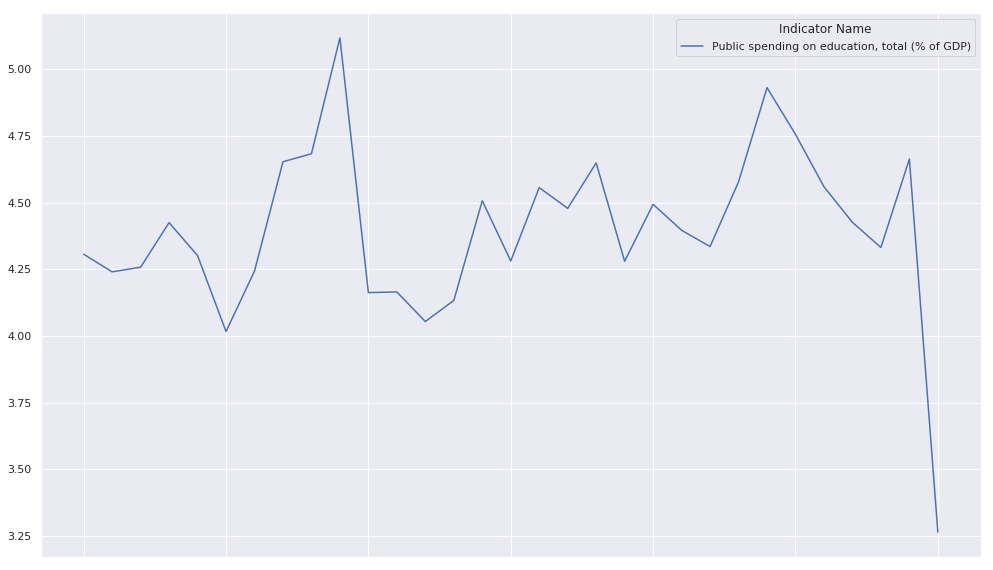

In [87]:
health[health['Indicator Name'].isin(['Public spending on education, total (% of GDP)'])].groupby('Indicator Name').mean().loc[:, '1985':'2015'].T.plot()


In [88]:
#health.groupby('Indicator Name').mean().loc[:, '1985':'2015']

In [89]:
human = pd.read_csv('../input/the-human-freedom-index/hfi_cc_2018.csv')
human.head()

,year,ISO_code,countries,region,pf_rol_procedural,pf_rol_civil,pf_rol_criminal,pf_rol,pf_ss_homicide,pf_ss_disappearances_disap,pf_ss_disappearances_violent,pf_ss_disappearances_organized,pf_ss_disappearances_fatalities,pf_ss_disappearances_injuries,pf_ss_disappearances,pf_ss_women_fgm,pf_ss_women_missing,pf_ss_women_inheritance_widows,pf_ss_women_inheritance_daughters,pf_ss_women_inheritance,pf_ss_women,pf_ss,pf_movement_domestic,pf_movement_foreign,pf_movement_women,pf_movement,pf_religion_estop_establish,pf_religion_estop_operate,pf_religion_estop,pf_religion_harassment,pf_religion_restrictions,pf_religion,pf_association_association,pf_association_assembly,pf_association_political_establish,pf_association_political_operate,pf_association_political,pf_association_prof_establish,pf_association_prof_operate,pf_association_prof,...,ef_money_inflation,ef_money_currency,ef_money,ef_trade_tariffs_revenue,ef_trade_tariffs_mean,ef_trade_tariffs_sd,ef_trade_tariffs,ef_trade_regulatory_nontariff,ef_trade_regulatory_compliance,ef_trade_regulatory,ef_trade_black,ef_trade_movement_foreign,ef_trade_movement_capital,ef_trade_movement_visit,ef_trade_movement,ef_trade,ef_regulation_credit_ownership,ef_regulation_credit_private,ef_regulation_credit_interest,ef_regulation_credit,ef_regulation_labor_minwage,ef_regulation_labor_firing,ef_regulation_labor_bargain,ef_regulation_labor_hours,ef_regulation_labor_dismissal,ef_regulation_labor_conscription,ef_regulation_labor,ef_regulation_business_adm,ef_regulation_business_bureaucracy,ef_regulation_business_start,ef_regulation_business_bribes,ef_regulation_business_licensing,ef_regulation_business_compliance,ef_regulation_business,ef_regulation,ef_score,ef_rank,hf_score,hf_rank,hf_quartile
0,2016,ALB,Albania,Eastern Europe,6.661503,4.547244,4.666508,5.291752,8.920429,10.0,10.00000,10.0,10.000000,10.000000,10.000000,10.0,7.5,5.0,5.0,5.0,7.500000,8.806810,5.0,10.0,5.0,6.666667,NaN,NaN,10.0,9.566667,8.011111,9.192593,10.0,10.0,NaN,NaN,10.0,NaN,NaN,10.0,...,9.74360,10.0,9.553657,9.626667,9.24,8.0240,8.963556,5.574481,9.405328,7.489905,10.00000,6.306106,4.615385,8.296923,6.406138,8.214900,5.0,7.295687,9.0,7.098562,5.566667,5.396399,6.234861,8.0,6.299741,10.0,6.916278,6.072172,6.000000,9.713864,4.050196,7.324582,7.074366,6.705863,6.906901,7.54,34.0,7.568140,48.0,2.0
1,2016,DZA,Algeria,Middle East & North Africa,NaN,NaN,NaN,3.819566,9.456254,10.0,9.29403,5.0,9.926119,9.990149,8.842060,10.0,7.5,0.0,0.0,0.0,5.833333,8.043882,5.0,5.0,5.0,5.000000,NaN,NaN,5.0,6.873333,2.961111,4.944815,5.0,5.0,NaN,NaN,5.0,NaN,NaN,5.0,...,8.72046,5.0,7.253894,8.480000,6.22,5.9176,6.872533,4.962589,0.000000,2.481294,5.56391,3.664829,0.000000,1.106256,1.590362,4.127025,0.0,5.301526,10.0,5.100509,5.566667,3.896912,5.958321,6.0,7.755176,1.0,5.029513,3.722341,1.777778,9.243070,3.765515,8.523503,7.029528,5.676956,5.268992,4.99,159.0,5.135886,155.0,4.0
2,2016,AGO,Angola,Sub-Saharan Africa,NaN,NaN,NaN,3.451814,8.060260,5.0,10.00000,7.5,10.000000,10.000000,8.500000,10.0,10.0,5.0,5.0,5.0,8.333333,8.297865,0.0,5.0,10.0,5.000000,NaN,NaN,10.0,8.904444,7.455556,8.786667,2.5,2.5,NaN,NaN,2.5,NaN,NaN,5.0,...,3.05400,5.0,5.606605,8.993333,7.72,4.2544,6.989244,3.132738,0.917160,2.024949,10.00000,2.946919,3.076923,0.110626,2.044823,5.264754,8.0,9.194715,4.0,7.064905,8.900000,2.656198,5.172987,4.0,6.632764,0.0,4.560325,2.758428,1.333333,8.664627,1.945540,8.096776,6.782923,4.930271,5.518500,5.17,155.0,5.640662,142.0,4.0
3,2016,ARG,Argentina,Latin America & the Caribbean,7.098483,5.791960,4.343930,5.744791,7.622974,10.0,10.00000,7.5,10.000000,9.990877,9.498175,10.0,10.0,10.0,10.0,10.0,10.000000,9.040383,10.0,10.0,10.0,10.000000,NaN,NaN,7.5,9.037778,6.850000,7.795926,7.5,10.0,NaN,NaN,5.0,NaN,NaN,7.5,...,2.00000,10.0,5.614336,6.060000,7.26,5.9448,6.421600,4.466582,5.155629,4.811105,0.00000,5.358169,0.769231,7.965046,4.697482,3.982547,5.0,4.259461,7.0,5.419820,2.766667,2.191898,3.432613,10.0,2.517254,10.0,5.151405,2.404211,6.666667,9.122357,3.260044,5.25

In [90]:
human.columns[-20:]

Index(['ef_regulation_labor_minwage', 'ef_regulation_labor_firing',
       'ef_regulation_labor_bargain', 'ef_regulation_labor_hours',
       'ef_regulation_labor_dismissal', 'ef_regulation_labor_conscription',
       'ef_regulation_labor', 'ef_regulation_business_adm',
       'ef_regulation_business_bureaucracy', 'ef_regulation_business_start',
       'ef_regulation_business_bribes', 'ef_regulation_business_licensing',
       'ef_regulation_business_compliance', 'ef_regulation_business',
       'ef_regulation', 'ef_score', 'ef_rank', 'hf_score', 'hf_rank',
       'hf_quartile'],
      dtype='object')

In [91]:
human[human['year']==2016].iloc[human[human['year']==2016].hf_score.idxmax()]

year                                         2016
ISO_code                                      NZL
countries                             New Zealand
region                                    Oceania
pf_rol_procedural                         8.36554
pf_rol_civil                              7.87734
pf_rol_criminal                           7.36276
pf_rol                                    7.86855
pf_ss_homicide                            9.60584
pf_ss_disappearances_disap                     10
pf_ss_disappearances_violent                   10
pf_ss_disappearances_organized                 10
pf_ss_disappearances_fatalities                10
pf_ss_disappearances_injuries                  10
pf_ss_disappearances                           10
pf_ss_women_fgm                                10
pf_ss_women_missing                            10
pf_ss_women_inheritance_widows                 10
pf_ss_women_inheritance_daughters              10
pf_ss_women_inheritance                        10


In [92]:
wh[wh.country=='New Zealand'].groupby('year').sum()

,suicides_no,population,scaled_population,scaled_suicides_no
year,,,,
1979,302.0,2257300.0,-1.186672,0.807018
1980,337.0,2585500.0,-1.224293,0.929825
1981,320.0,2616500.0,-1.199774,0.780702
1982,364.0,2648900.0,-1.174148,1.166667
1983,352.0,2975000.0,-1.213429,0.877193
1984,389.0,3006300.0,-1.188673,1.201754
1985,338.0,3025800.0,-1.173250,0.754386
1986,414.0,3026100.0,-1.173013,1.421053
1987,463.0,3047100.0,-1.156403,1.850877


In [93]:
human[human.countries=='New Zealand'].sort_values('year')[['year','hf_score']]

,year,hf_score
1403,2008,8.910542
1241,2009,8.797717
1079,2010,8.879077
917,2011,8.791730
755,2012,8.784639
593,2013,8.868585
431,2014,8.921386
269,2015,8.876890
107,2016,8.887410


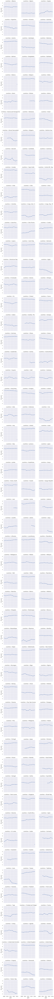

In [94]:
g = sns.FacetGrid(human[['countries','year','hf_score']], col="countries", col_wrap=3)
g = g.map(plt.plot, "year", "hf_score", marker=".")

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


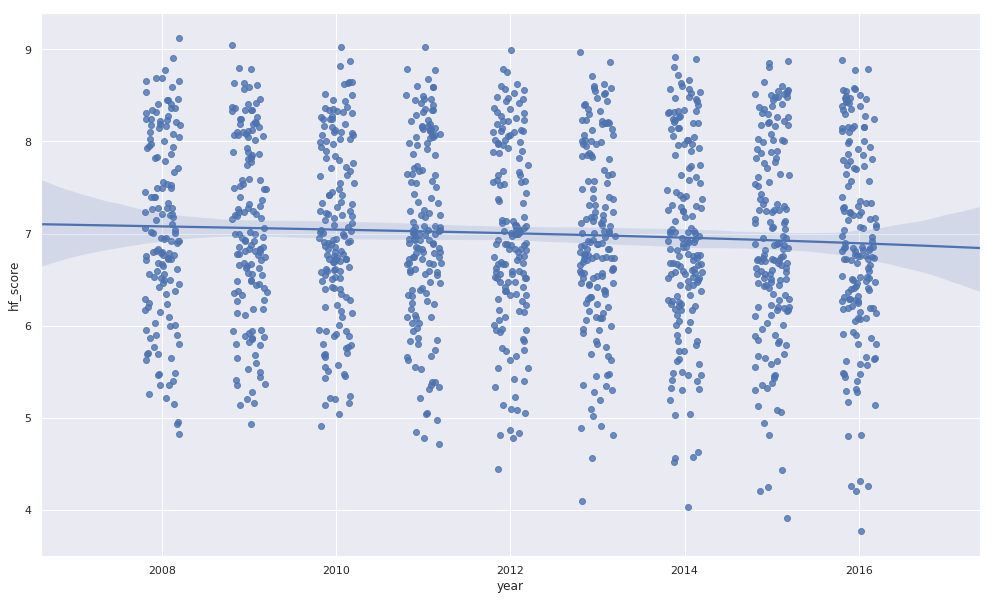

In [95]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.regplot(data=human, x='year', y='hf_score', x_jitter=0.2, order=3)
#ax.set_yscale('log')

/opt/conda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


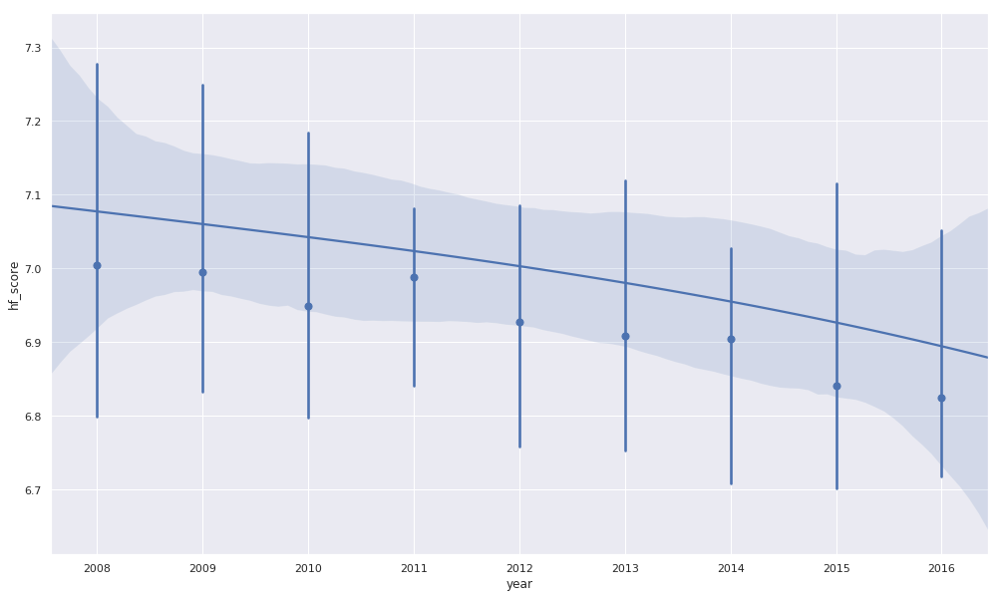

In [96]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.regplot(data=human, x='year', y='hf_score', x_jitter=0.2, order=3, x_estimator=np.median)

In [97]:
mtech = pd.read_csv('../input/mental-health-in-tech-survey/survey.csv')

In [98]:
#mtech.columns

# https://www.kaggle.com/osmi/mental-health-in-tech-survey


# * family_history - Do you have a family history of mental illness?
# * treatment - Have you sought treatment for a mental health condition?
# * work_interfere - If you have a mental health condition, do you feel that it interferes with your work?
# * remote_work - Do you work remotely (outside of an office) at least 50% of the time?
# * tech_company - Is your employer primarily a tech company/organization?
# * benefits - Does your employer provide mental health benefits?
# * care_options - Do you know the options for mental health care your employer provides?
# * wellness_program - Has your employer ever discussed mental health as part of an employee wellness program?
# * seek_help - Does your employer provide resources to learn more about mental health issues and how to seek help?
# * anonymity - Is your anonymity protected if you choose to take advantage of mental health or substance abuse treatment resources?
# * leave - How easy is it for you to take medical leave for a mental health condition?
# * mental_health_consequence - Do you think that discussing a mental health issue with your employer would have negative consequences?
# * phys_health_consequence - Do you think that discussing a physical health issue with your employer would have negative consequences?
# * coworkers - Would you be willing to discuss a mental health issue with your coworkers?
# * supervisor - Would you be willing to discuss a mental health issue with your direct supervisor(s)?
# * mental_health_interview - Would you bring up a mental health issue with a potential employer in an interview?
# * phys_health_interview - Would you bring up a physical health issue with a potential employer in an interview?
# * mental_vs_physical - Do you feel that your employer takes mental health as seriously as physical health?
# * obs_consequence - Have you heard of or observed negative consequences for coworkers with mental health conditions in your workplace?

In [99]:
mtech.describe(include='all')

,Timestamp,Age,Gender,Country,state,self_employed,family_history,treatment,work_interfere,no_employees,remote_work,tech_company,benefits,care_options,wellness_program,seek_help,anonymity,leave,mental_health_consequence,phys_health_consequence,coworkers,supervisor,mental_health_interview,phys_health_interview,mental_vs_physical,obs_consequence,comments
count,1259,1.259000e+03,1259,1259,744,1241,1259,1259,995,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,1259,164
unique,1246,NaN,49,48,45,2,2,2,4,6,2,2,3,3,3,3,3,5,3,3,3,3,3,3,3,2,160
top,2014-08-27 12:37:50,NaN,Male,United States,CA,No,No,Yes,Sometimes,6-25,No,Yes,Yes,No,No,No,Don't know,Don't know,No,No,Some of them,Yes,No,Maybe,Don't know,No,* Small family business - YMMV.
freq,2,NaN,615,751,138,1095,767,637,465,290,883,1031,477,501,842,646,819,563,490,925,774,516,1008,557,576,1075,5
mean,NaN,7.942815e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,2.818299e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,-1.726000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,2.700000e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,3.100000e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,3.600000e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


* self_employed - Are you self-employed?
* remote_work - Do you work remotely (outside of an office) at least 50% of the time?
* tech_company - Is your employer primarily a tech company/organization?

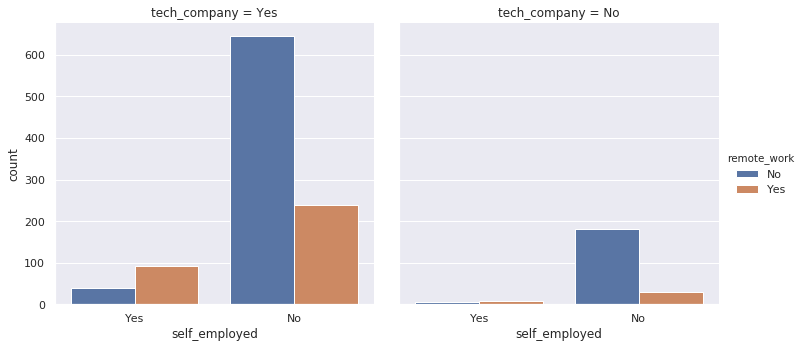

In [100]:
sns.catplot(x='self_employed', hue='remote_work', col='tech_company', kind='count', data=mtech)

* anonymity - Is your anonymity protected if you choose to take advantage of mental health or substance abuse treatment resources?
* leave - How easy is it for you to take medical leave for a mental health condition?
* coworkers - Would you be willing to discuss a mental health issue with your coworkers?
* supervisor - Would you be willing to discuss a mental health issue with your direct supervisor(s)?

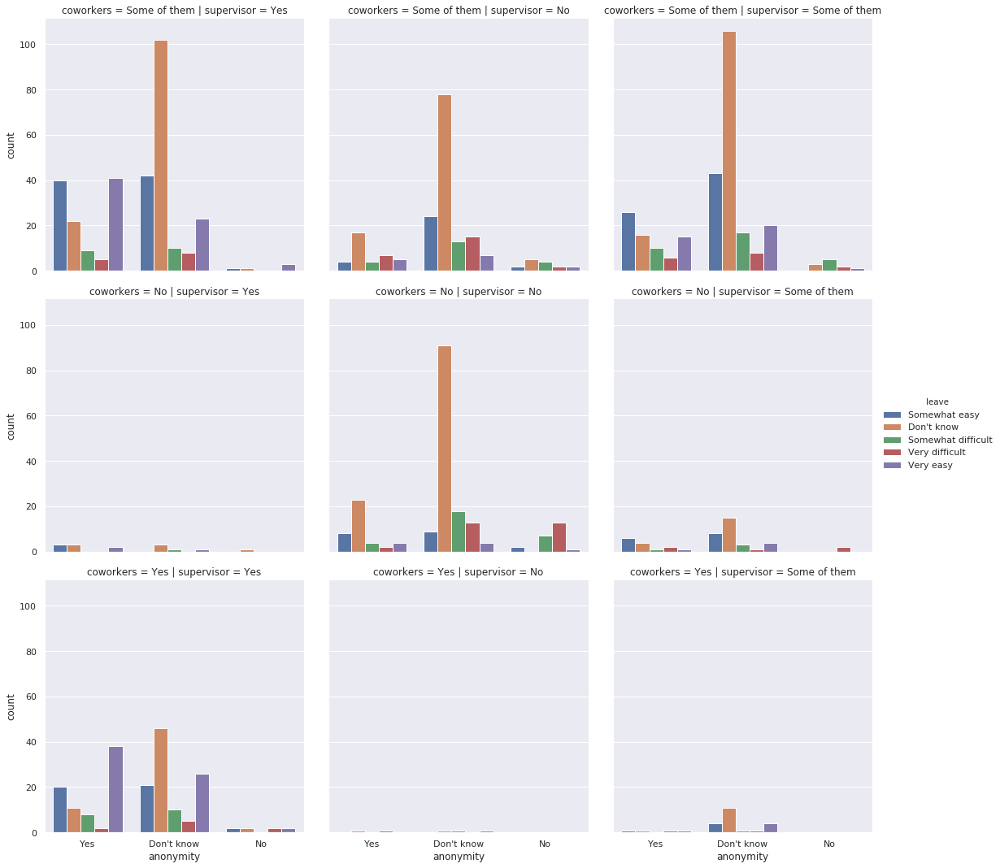

In [101]:
sns.catplot(x='anonymity', hue='leave', col='supervisor', row='coworkers', kind='count', data=mtech)

* treatment - Have you sought treatment for a mental health condition?
* benefits - Does your employer provide mental health benefits?
* care_options - Do you know the options for mental health care your employer provides?
* wellness_program - Has your employer ever discussed mental health as part of an employee wellness program?


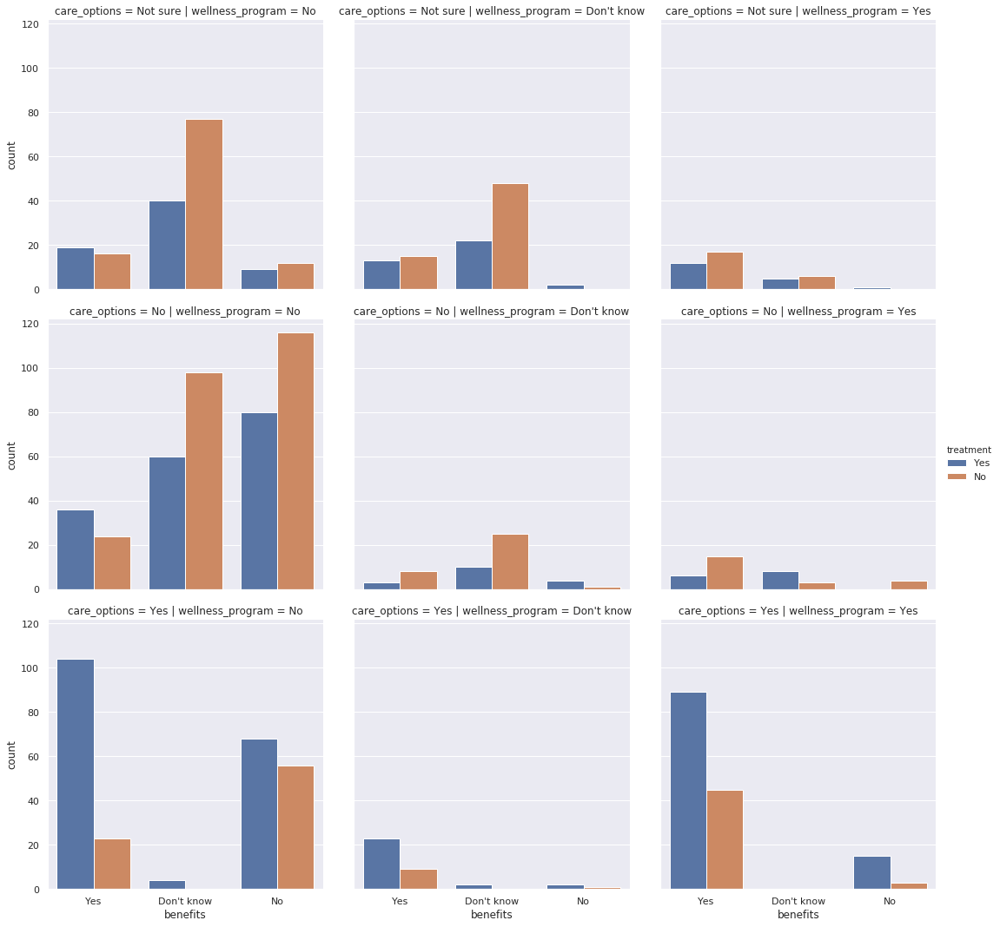

In [102]:
sns.catplot(x='benefits', hue='treatment', col='wellness_program', row='care_options',kind='count', data=mtech)

* seek_help - Does your employer provide resources to learn more about mental health issues and how to seek help?
* mental_health_consequence - Do you think that discussing a mental health issue with your employer would have negative consequences?
* family_history - Do you have a family history of mental illness?
* treatment - Have you sought treatment for a mental health condition?


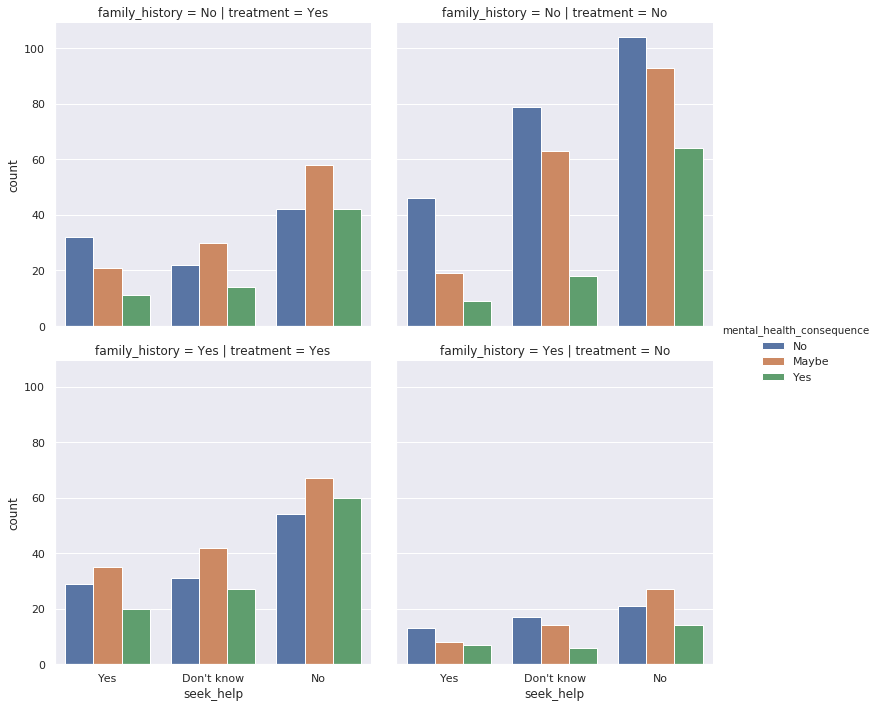

In [103]:
sns.catplot(x='seek_help', hue='mental_health_consequence', col='treatment', row='family_history', kind='count', data=mtech)